In [1]:
import zipfile
import h5py
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, f1_score, recall_score
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input, decode_predictions
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.regularizers import l2
from keras.utils import to_categorical

%matplotlib inline
np.random.seed(42)

In [2]:
# Parameter
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
COLOR_CHANNELS = 3
BATCH_SIZE = 32
EPOCHS = 25
K = 5  # Jumlah fold

In [5]:
data_dir = train_dir

# Membuat dataframe dari dataset
image_paths = []
labels = []

for class_name in os.listdir(data_dir):
    class_dir = os.path.join(data_dir, class_name)
    if os.path.isdir(class_dir):  
        for img_name in os.listdir(class_dir):
            image_paths.append(os.path.join(class_dir, img_name))
            labels.append(class_name)

df = pd.DataFrame({"filename": image_paths, "class": labels})

# Konversi label ke angka
label_encoder = LabelEncoder()
df["label"] = label_encoder.fit_transform(df["class"])

print("✅ Dataset berhasil dimuat! Jumlah data:", len(df))
pd.set_option('display.max_colwidth', None)
df.head(len(df))

✅ Dataset berhasil dimuat! Jumlah data: 7000


,filename,class,label
0,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1000_Mega_Mendung_155.jpg,JawaBarat_Megamendung,0
1,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1001_Mega_Mendung_159.jpg,JawaBarat_Megamendung,0
2,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1002_Mega_Mendung_160.jpg,JawaBarat_Megamendung,0
3,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1003_Mega_Mendung_161.jpg,JawaBarat_Megamendung,0
4,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\JawaBarat_Megamendung\aug_1004_Mega_Mendung_164.jpg,JawaBarat_Megamendung,0
...,...,...,...
6995,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_92.jpg,Yogyakarta_Kawung,6
6996,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_93.jpg,Yogyakarta_Kawung,6
6997,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_94.jpg,Yogyakarta_Kawung,6
6998,../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train\Yogyakarta_Kawung\Kawung_96.jpg,Yogyakarta_Kawung,6


In [7]:
# Fungsi untuk membuat model MobileNetV2
def create_model():
    base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(
        weights="imagenet", include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS)
    )
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    
    # Menambahkan layer output dengan weight decay
    predictions = Dense(len(label_encoder.classes_), activation="softmax")(x)
    
    model = Model(inputs=base_model.input, outputs=predictions)

    # Compile model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Cek model
model = create_model()
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,266,951 (8.65 MB)

 Trainable params: 2,232,839 (8.52 MB)

 Non-trainable params: 34,112 (133.25 KB)


🔹 Training Fold 1/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8000 - loss: 0.6419

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(



Epoch 1: val_loss improved from inf to 5.81344, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 620s 3s/step - accuracy: 0.8003 - loss: 0.6410 - val_accuracy: 0.5714 - val_loss: 5.8134
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9304 - loss: 0.2384
Epoch 2: val_loss improved from 5.81344 to 5.55916, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 592s 3s/step - accuracy: 0.9304 - loss: 0.2384 - val_accuracy: 0.5443 - val_loss: 5.5592
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9599 - loss: 0.1349
Epoch 3: val_loss did not improve from 5.55916
175/175 ━━━━━━━━━━━━━━━━━━━━ 590s 3s/step - accuracy: 0.9599 - loss: 0.1349 - val_accuracy: 0.4593 - val_loss: 10.8831
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9680 - loss: 0.1022
Epoch 4: val_loss did not improve from 5.55916
175/175 ━━━━━━━━━━━━━━━━━━━━ 590s 3s/step - accuracy: 0.9681 - loss: 0.1022 - val_accuracy: 0.5879 - val_loss: 7.0412
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9741 - loss: 0.0865
Epoch 5: val_loss did not improve from 5.55916
175/175 ━━━━━━━━━━━━━━━━━━━━ 591s 3s/step - accuracy: 0.9740 - loss: 0.0866 - val_accuracy: 0.3214 - val_loss: 14.2627
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9717 - loss: 0.0951
Epoch 6: val_loss did not improve from 5.5591

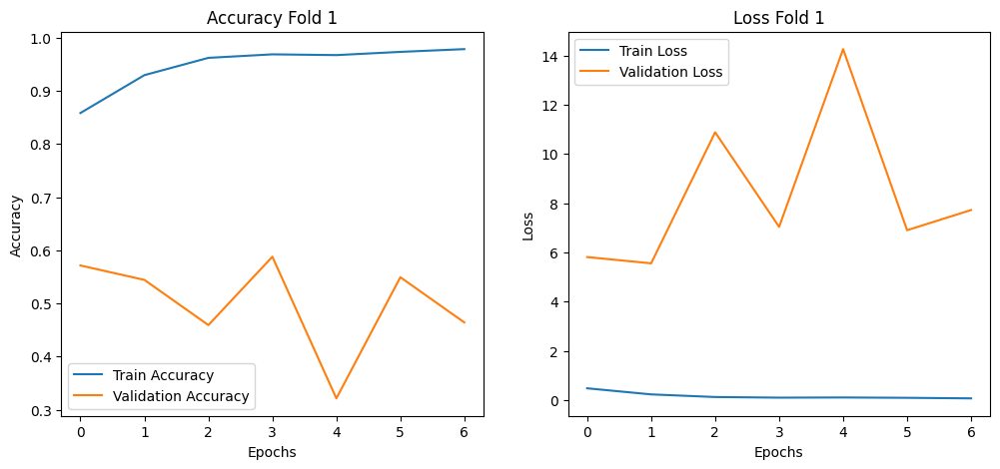


🔹 Training Fold 2/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
162/175 ━━━━━━━━━━━━━━━━━━━━ 41s 3s/step - accuracy: 0.7662 - loss: 0.7416

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7714 - loss: 0.7254
Epoch 1: val_loss improved from inf to 5.19584, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 613s 3s/step - accuracy: 0.7718 - loss: 0.7242 - val_accuracy: 0.6757 - val_loss: 5.1958
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9147 - loss: 0.2788
Epoch 2: val_loss did not improve from 5.19584
175/175 ━━━━━━━━━━━━━━━━━━━━ 592s 3s/step - accuracy: 0.9148 - loss: 0.2785 - val_accuracy: 0.4771 - val_loss: 5.5940
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9604 - loss: 0.1331
Epoch 3: val_loss did not improve from 5.19584
175/175 ━━━━━━━━━━━━━━━━━━━━ 592s 3s/step - accuracy: 0.9604 - loss: 0.1331 - val_accuracy: 0.3771 - val_loss: 13.2797
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9650 - loss: 0.1064
Epoch 4: val_loss did not improve from 5.19584
175/175 ━━━━━━━━━━━━━━━━━━━━ 595s 3s/step - accuracy: 0.9650 - loss: 0.1066 - val_accuracy: 0.4764 - val_loss: 8.4548
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9761 - loss: 0.0769
Epoch 5: val_loss improved from 5.19584 to 3.6

175/175 ━━━━━━━━━━━━━━━━━━━━ 576s 3s/step - accuracy: 0.9761 - loss: 0.0769 - val_accuracy: 0.6814 - val_loss: 3.6187
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9698 - loss: 0.0999
Epoch 6: val_loss did not improve from 3.61870
175/175 ━━━━━━━━━━━━━━━━━━━━ 574s 3s/step - accuracy: 0.9697 - loss: 0.1000 - val_accuracy: 0.5221 - val_loss: 4.9082
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9727 - loss: 0.0896
Epoch 7: val_loss improved from 3.61870 to 2.59703, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 575s 3s/step - accuracy: 0.9727 - loss: 0.0897 - val_accuracy: 0.7771 - val_loss: 2.5970
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9834 - loss: 0.0561
Epoch 8: val_loss did not improve from 2.59703
175/175 ━━━━━━━━━━━━━━━━━━━━ 576s 3s/step - accuracy: 0.9834 - loss: 0.0561 - val_accuracy: 0.6343 - val_loss: 6.1849
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9850 - loss: 0.0494
Epoch 9: val_loss did not improve from 2.59703
175/175 ━━━━━━━━━━━━━━━━━━━━ 585s 3s/step - accuracy: 0.9850 - loss: 0.0495 - val_accuracy: 0.5536 - val_loss: 7.9256
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9806 - loss: 0.0542
Epoch 10: val_loss did not improve from 2.59703
175/175 ━━━━━━━━━━━━━━━━━━━━ 580s 3s/step - accuracy: 0.9806 - loss: 0.0542 - val_accuracy: 0.5093 - val_loss: 9.4674
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9734 - loss: 0.0791
Epoch 11: val_loss did not improve from 2.59

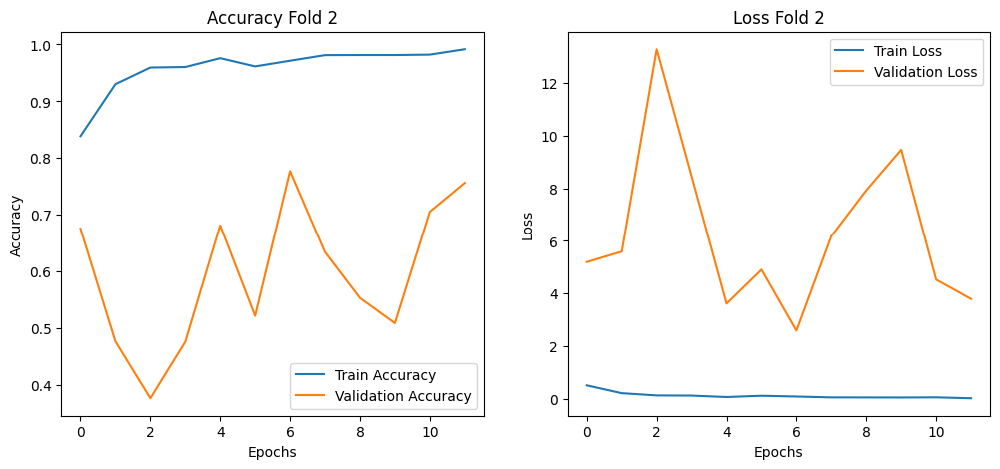


🔹 Training Fold 3/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
129/175 ━━━━━━━━━━━━━━━━━━━━ 2:22 3s/step - accuracy: 0.7703 - loss: 0.7312

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7903 - loss: 0.6744
Epoch 1: val_loss improved from inf to 8.17342, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 593s 3s/step - accuracy: 0.7907 - loss: 0.6734 - val_accuracy: 0.5050 - val_loss: 8.1734
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9166 - loss: 0.2523
Epoch 2: val_loss improved from 8.17342 to 4.05702, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 581s 3s/step - accuracy: 0.9167 - loss: 0.2521 - val_accuracy: 0.7421 - val_loss: 4.0570
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9335 - loss: 0.2246
Epoch 3: val_loss improved from 4.05702 to 3.14964, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 586s 3s/step - accuracy: 0.9335 - loss: 0.2243 - val_accuracy: 0.6357 - val_loss: 3.1496
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9628 - loss: 0.1361
Epoch 4: val_loss did not improve from 3.14964
175/175 ━━━━━━━━━━━━━━━━━━━━ 578s 3s/step - accuracy: 0.9627 - loss: 0.1362 - val_accuracy: 0.4579 - val_loss: 7.2748
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9746 - loss: 0.0812
Epoch 5: val_loss did not improve from 3.14964
175/175 ━━━━━━━━━━━━━━━━━━━━ 577s 3s/step - accuracy: 0.9745 - loss: 0.0813 - val_accuracy: 0.5850 - val_loss: 6.5585
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9696 - loss: 0.1024
Epoch 6: val_loss did not improve from 3.14964
175/175 ━━━━━━━━━━━━━━━━━━━━ 577s 3s/step - accuracy: 0.9696 - loss: 0.1023 - val_accuracy: 0.4807 - val_loss: 8.8686
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9760 - loss: 0.0698
Epoch 7: val_loss improved from 3.14964 to 2.42

175/175 ━━━━━━━━━━━━━━━━━━━━ 578s 3s/step - accuracy: 0.9759 - loss: 0.0699 - val_accuracy: 0.7014 - val_loss: 2.4215
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9773 - loss: 0.0727
Epoch 8: val_loss did not improve from 2.42146
175/175 ━━━━━━━━━━━━━━━━━━━━ 590s 3s/step - accuracy: 0.9773 - loss: 0.0726 - val_accuracy: 0.7050 - val_loss: 2.5243
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9850 - loss: 0.0553
Epoch 9: val_loss did not improve from 2.42146
175/175 ━━━━━━━━━━━━━━━━━━━━ 579s 3s/step - accuracy: 0.9850 - loss: 0.0553 - val_accuracy: 0.6393 - val_loss: 4.7728
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9800 - loss: 0.0667
Epoch 10: val_loss did not improve from 2.42146
175/175 ━━━━━━━━━━━━━━━━━━━━ 579s 3s/step - accuracy: 0.9800 - loss: 0.0667 - val_accuracy: 0.7007 - val_loss: 4.4965
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9883 - loss: 0.0387
Epoch 11: val_loss did not improve from 2.42

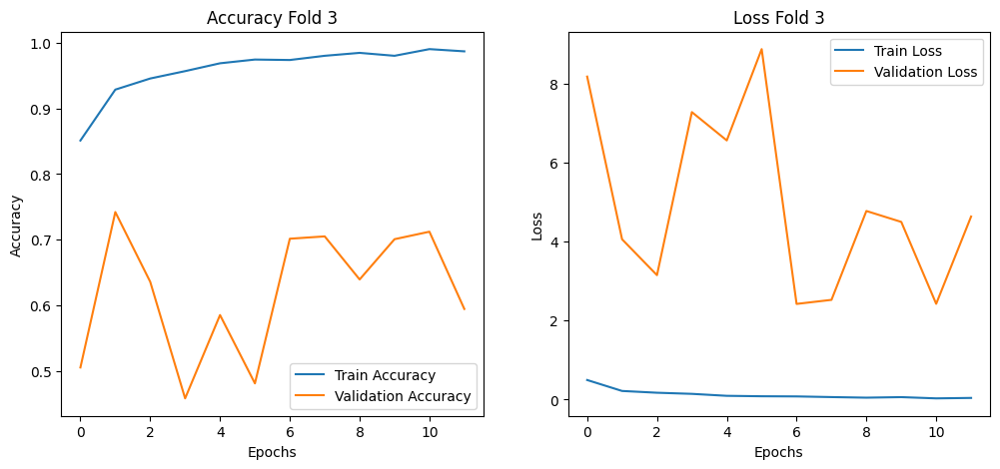


🔹 Training Fold 4/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
 59/175 ━━━━━━━━━━━━━━━━━━━━ 6:02 3s/step - accuracy: 0.7192 - loss: 0.8751

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7929 - loss: 0.6636
Epoch 1: val_loss improved from inf to 6.94261, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 598s 3s/step - accuracy: 0.7932 - loss: 0.6626 - val_accuracy: 0.5821 - val_loss: 6.9426
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9275 - loss: 0.2478
Epoch 2: val_loss did not improve from 6.94261
175/175 ━━━━━━━━━━━━━━━━━━━━ 577s 3s/step - accuracy: 0.9275 - loss: 0.2478 - val_accuracy: 0.3079 - val_loss: 12.5745
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9420 - loss: 0.1842
Epoch 3: val_loss did not improve from 6.94261
175/175 ━━━━━━━━━━━━━━━━━━━━ 585s 3s/step - accuracy: 0.9420 - loss: 0.1842 - val_accuracy: 0.1771 - val_loss: 29.0631
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9742 - loss: 0.0847
Epoch 4: val_loss did not improve from 6.94261
175/175 ━━━━━━━━━━━━━━━━━━━━ 578s 3s/step - accuracy: 0.9742 - loss: 0.0848 - val_accuracy: 0.3579 - val_loss: 11.4593
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9726 - loss: 0.0871
Epoch 5: val_loss did not improve from 6.942

175/175 ━━━━━━━━━━━━━━━━━━━━ 578s 3s/step - accuracy: 0.9735 - loss: 0.0807 - val_accuracy: 0.6236 - val_loss: 3.9154
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9695 - loss: 0.0928
Epoch 7: val_loss did not improve from 3.91539
175/175 ━━━━━━━━━━━━━━━━━━━━ 577s 3s/step - accuracy: 0.9695 - loss: 0.0927 - val_accuracy: 0.6643 - val_loss: 5.2896
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9803 - loss: 0.0615
Epoch 8: val_loss improved from 3.91539 to 2.54518, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 577s 3s/step - accuracy: 0.9803 - loss: 0.0615 - val_accuracy: 0.7036 - val_loss: 2.5452
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9890 - loss: 0.0330
Epoch 9: val_loss improved from 2.54518 to 1.09435, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 590s 3s/step - accuracy: 0.9890 - loss: 0.0331 - val_accuracy: 0.8421 - val_loss: 1.0944
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9856 - loss: 0.0415
Epoch 10: val_loss did not improve from 1.09435
175/175 ━━━━━━━━━━━━━━━━━━━━ 576s 3s/step - accuracy: 0.9856 - loss: 0.0416 - val_accuracy: 0.5879 - val_loss: 8.0489
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9778 - loss: 0.0671
Epoch 11: val_loss did not improve from 1.09435
175/175 ━━━━━━━━━━━━━━━━━━━━ 576s 3s/step - accuracy: 0.9779 - loss: 0.0671 - val_accuracy: 0.6157 - val_loss: 5.3619
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9815 - loss: 0.0613
Epoch 12: val_loss did not improve from 1.09435
175/175 ━━━━━━━━━━━━━━━━━━━━ 585s 3s/step - accuracy: 0.9815 - loss: 0.0613 - val_accuracy: 0.5686 - val_loss: 5.5836
Epoch 13/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9756 - loss: 0.0751
Epoch 13: val_loss did not improve from 

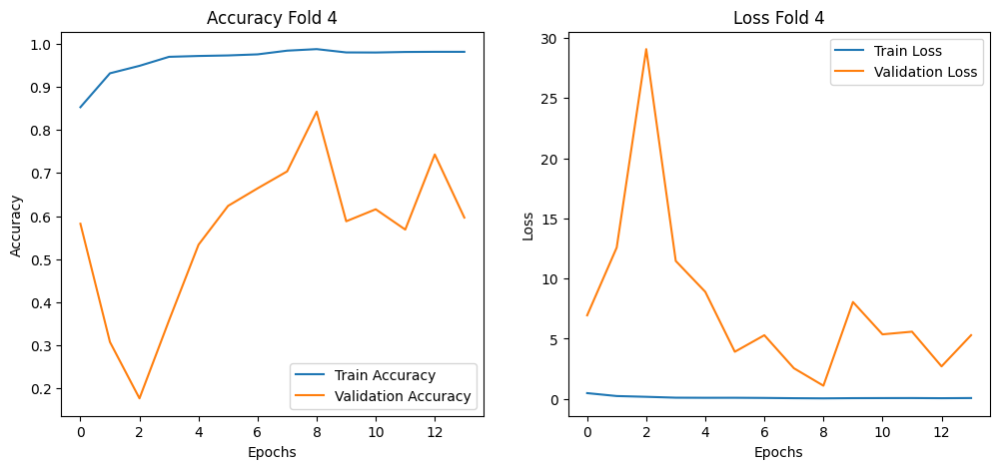


🔹 Training Fold 5/5
Found 5600 validated image filenames belonging to 7 classes.
Found 1400 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
 29/175 ━━━━━━━━━━━━━━━━━━━━ 7:34 3s/step - accuracy: 0.6314 - loss: 1.1339

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7829 - loss: 0.6850
Epoch 1: val_loss improved from inf to 13.60653, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 596s 3s/step - accuracy: 0.7833 - loss: 0.6838 - val_accuracy: 0.3521 - val_loss: 13.6065
Epoch 2/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9244 - loss: 0.2587
Epoch 2: val_loss improved from 13.60653 to 5.72033, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 578s 3s/step - accuracy: 0.9244 - loss: 0.2588 - val_accuracy: 0.5657 - val_loss: 5.7203
Epoch 3/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9492 - loss: 0.1827
Epoch 3: val_loss did not improve from 5.72033
175/175 ━━━━━━━━━━━━━━━━━━━━ 576s 3s/step - accuracy: 0.9492 - loss: 0.1825 - val_accuracy: 0.3457 - val_loss: 16.8762
Epoch 4/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9659 - loss: 0.1099
Epoch 4: val_loss improved from 5.72033 to 1.78232, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


175/175 ━━━━━━━━━━━━━━━━━━━━ 576s 3s/step - accuracy: 0.9659 - loss: 0.1099 - val_accuracy: 0.8021 - val_loss: 1.7823
Epoch 5/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9733 - loss: 0.0832
Epoch 5: val_loss did not improve from 1.78232
175/175 ━━━━━━━━━━━━━━━━━━━━ 575s 3s/step - accuracy: 0.9733 - loss: 0.0833 - val_accuracy: 0.6829 - val_loss: 4.9178
Epoch 6/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9865 - loss: 0.0514
Epoch 6: val_loss did not improve from 1.78232
175/175 ━━━━━━━━━━━━━━━━━━━━ 575s 3s/step - accuracy: 0.9864 - loss: 0.0514 - val_accuracy: 0.5736 - val_loss: 5.7963
Epoch 7/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9726 - loss: 0.0863
Epoch 7: val_loss did not improve from 1.78232
175/175 ━━━━━━━━━━━━━━━━━━━━ 575s 3s/step - accuracy: 0.9726 - loss: 0.0865 - val_accuracy: 0.6093 - val_loss: 6.0498
Epoch 8/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9763 - loss: 0.0702
Epoch 8: val_loss improved from 1.78232 to 1.55

175/175 ━━━━━━━━━━━━━━━━━━━━ 598s 3s/step - accuracy: 0.9763 - loss: 0.0701 - val_accuracy: 0.8414 - val_loss: 1.5595
Epoch 9/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9827 - loss: 0.0616
Epoch 9: val_loss did not improve from 1.55951
175/175 ━━━━━━━━━━━━━━━━━━━━ 587s 3s/step - accuracy: 0.9827 - loss: 0.0617 - val_accuracy: 0.7179 - val_loss: 3.4072
Epoch 10/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9829 - loss: 0.0537
Epoch 10: val_loss did not improve from 1.55951
175/175 ━━━━━━━━━━━━━━━━━━━━ 581s 3s/step - accuracy: 0.9829 - loss: 0.0538 - val_accuracy: 0.5621 - val_loss: 9.8236
Epoch 11/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9698 - loss: 0.1052
Epoch 11: val_loss did not improve from 1.55951
175/175 ━━━━━━━━━━━━━━━━━━━━ 584s 3s/step - accuracy: 0.9698 - loss: 0.1051 - val_accuracy: 0.5807 - val_loss: 7.0139
Epoch 12/25
175/175 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9867 - loss: 0.0463
Epoch 12: val_loss did not improve from 1.

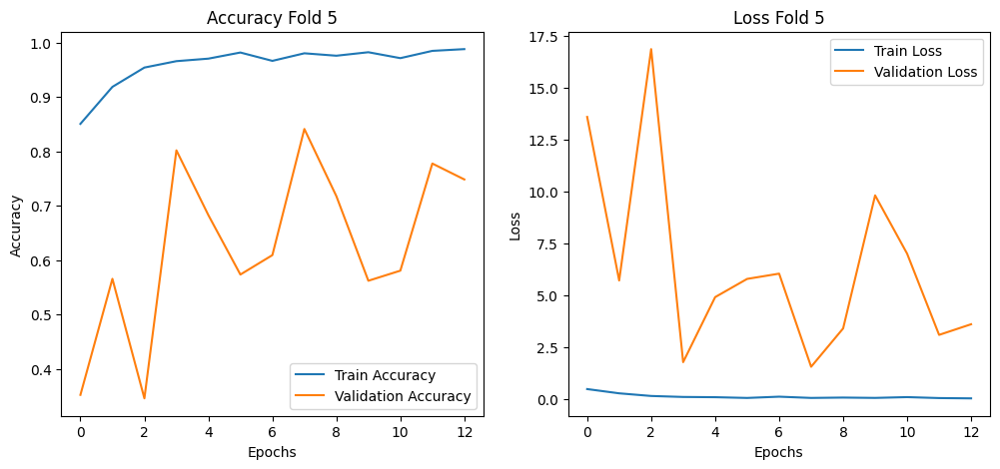


✅ Training selesai untuk semua fold!


In [10]:
# Stratified K-Fold
skf = StratifiedKFold(n_splits=K, shuffle=True, random_state=42)

# Melakukan K-Fold Cross Validation
for fold, (train_idx, val_idx) in enumerate(skf.split(df["filename"], df["label"])):
    print(f"\n🔹 Training Fold {fold+1}/{K}")

    # Membagi dataset berdasarkan indeks
    train_df = df.iloc[train_idx]
    val_df = df.iloc[val_idx]

    # Data augmentation dan preprocessing
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    train_generator = train_datagen.flow_from_dataframe(
        train_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=True
    )

    val_generator = val_datagen.flow_from_dataframe(
        val_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=False
    )

    # Buat model baru untuk setiap fold
    model = create_model()

    # Callback untuk early stopping dan penyimpanan model terbaik
    early_stopping = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)
    model_checkpoint = ModelCheckpoint(f"Batik_Nusantara_7_MobileNetV2_Fold{fold+1}.h5",
                                       monitor="val_loss", save_best_only=True, mode="min", verbose=1)

    # Training model
    history = model.fit(
        train_generator,
        validation_data=val_generator,
        epochs=EPOCHS,
        callbacks=[early_stopping, model_checkpoint],
        verbose=1
    )

    # 🔹 Plot Training & Validation Accuracy untuk Fold ini
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Accuracy Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # 🔹 Plot Training & Validation Loss untuk Fold ini
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Loss Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()  # Menampilkan plot setelah setiap fold selesai

print("\n✅ Training selesai untuk semua fold!")


In [3]:
train_dir = '../../Dataset/Dataset_Nusantara_7_augmented_1100_split/train'
test_dir = '../../Dataset/Dataset_Nusantara_7_augmented_1100_split/test'

# Preprocessing data testing
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    shuffle=False  # Agar urutan gambar tetap sama untuk semua model
)

# Evaluasi tiap model per fold
num_folds = 5  # Jumlah fold
models = [f"Batik_Nusantara_7_MobileNetV2_Fold{i+1}.h5" for i in range(num_folds)]

for i, model_path in enumerate(models):
    print(f"\n🔹 Evaluating Model Fold {i+1}: {model_path}")
    
    # Load model
    model = tf.keras.models.load_model(model_path)
    
    # Evaluasi model
    loss, accuracy = model.evaluate(test_generator, verbose=1)
    
    # Tampilkan hasil evaluasi
    print(f"✅ Fold {i+1}: Loss = {loss:.4f}, Accuracy = {accuracy:.4f}")


Found 700 images belonging to 7 classes.

🔹 Evaluating Model Fold 1: Batik_Nusantara_7_MobileNetV2_Fold1.h5


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


22/22 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.4486 - loss: 5.4516
✅ Fold 1: Loss = 5.5890, Accuracy = 0.5471

🔹 Evaluating Model Fold 2: Batik_Nusantara_7_MobileNetV2_Fold2.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 23s 686ms/step - accuracy: 0.6202 - loss: 4.4061
✅ Fold 2: Loss = 2.2903, Accuracy = 0.7900

🔹 Evaluating Model Fold 3: Batik_Nusantara_7_MobileNetV2_Fold3.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 17s 698ms/step - accuracy: 0.6482 - loss: 2.7834
✅ Fold 3: Loss = 2.3047, Accuracy = 0.7157

🔹 Evaluating Model Fold 4: Batik_Nusantara_7_MobileNetV2_Fold4.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 781ms/step - accuracy: 0.7468 - loss: 1.6737
✅ Fold 4: Loss = 1.2346, Accuracy = 0.8400

🔹 Evaluating Model Fold 5: Batik_Nusantara_7_MobileNetV2_Fold5.h5


22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 990ms/step - accuracy: 0.8017 - loss: 2.0546
✅ Fold 5: Loss = 1.6698, Accuracy = 0.8386


Evaluasi Model KFold 1

22/22 ━━━━━━━━━━━━━━━━━━━━ 22s 942ms/step


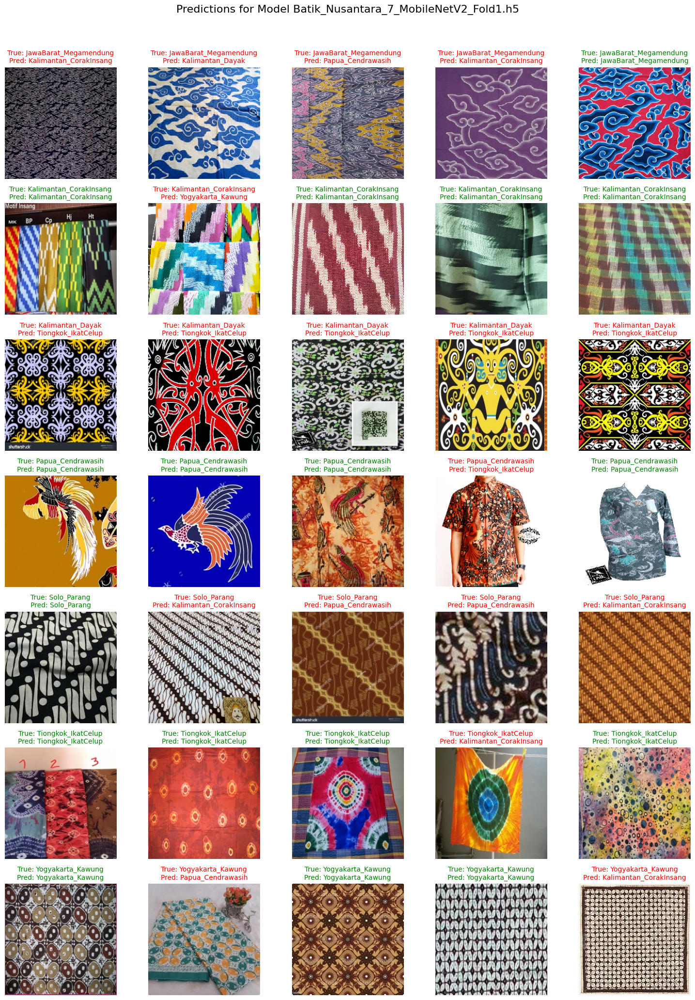

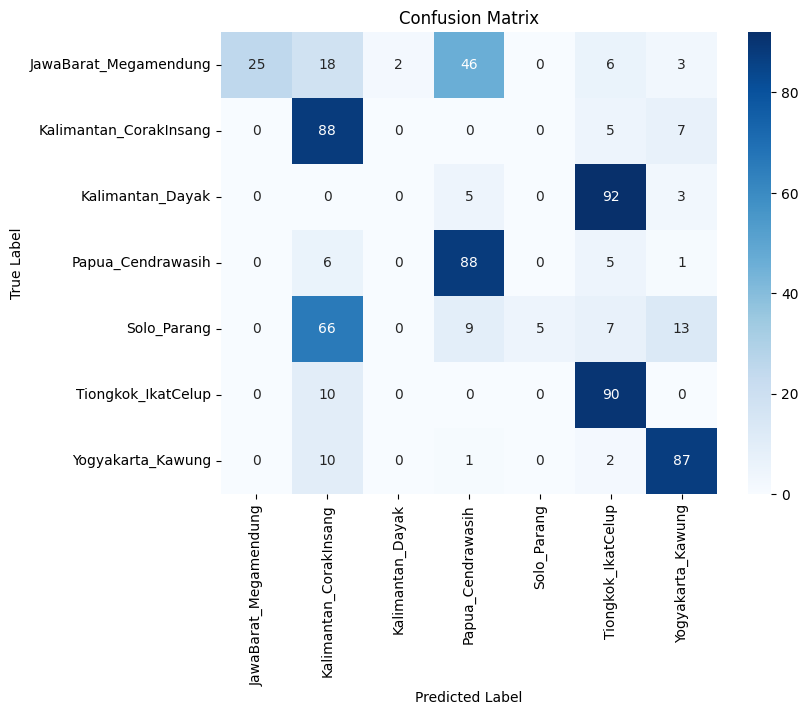

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       1.00      0.25      0.40       100
Kalimantan_CorakInsang       0.44      0.88      0.59       100
      Kalimantan_Dayak       0.00      0.00      0.00       100
     Papua_Cendrawasih       0.59      0.88      0.71       100
           Solo_Parang       1.00      0.05      0.10       100
    Tiongkok_IkatCelup       0.43      0.90      0.59       100
     Yogyakarta_Kawung       0.76      0.87      0.81       100

              accuracy                           0.55       700
             macro avg       0.60      0.55      0.46       700
          weighted avg       0.60      0.55      0.46       700



In [4]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold1.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_11140\3700777095.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


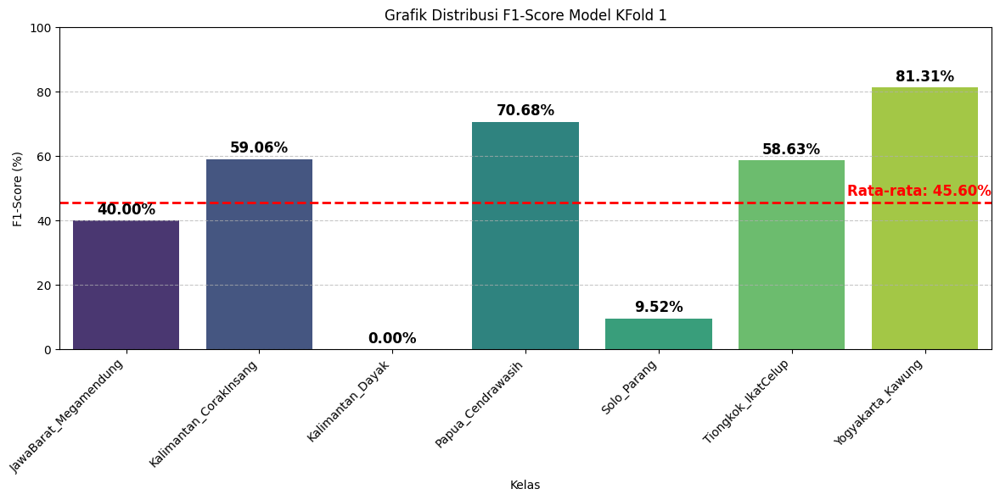

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 1")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 2

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 836ms/step


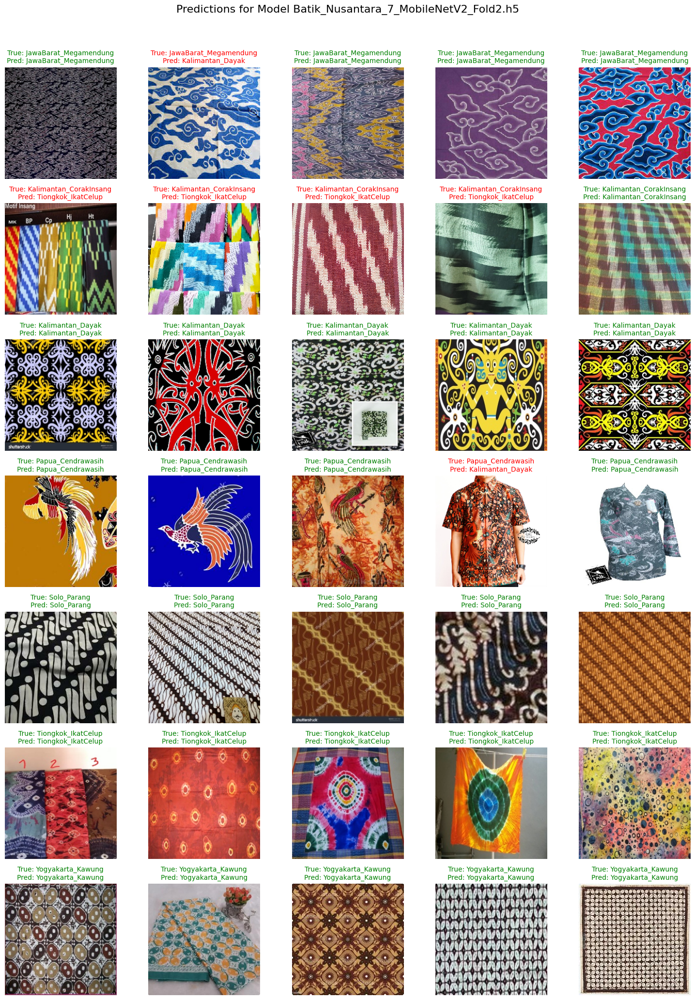

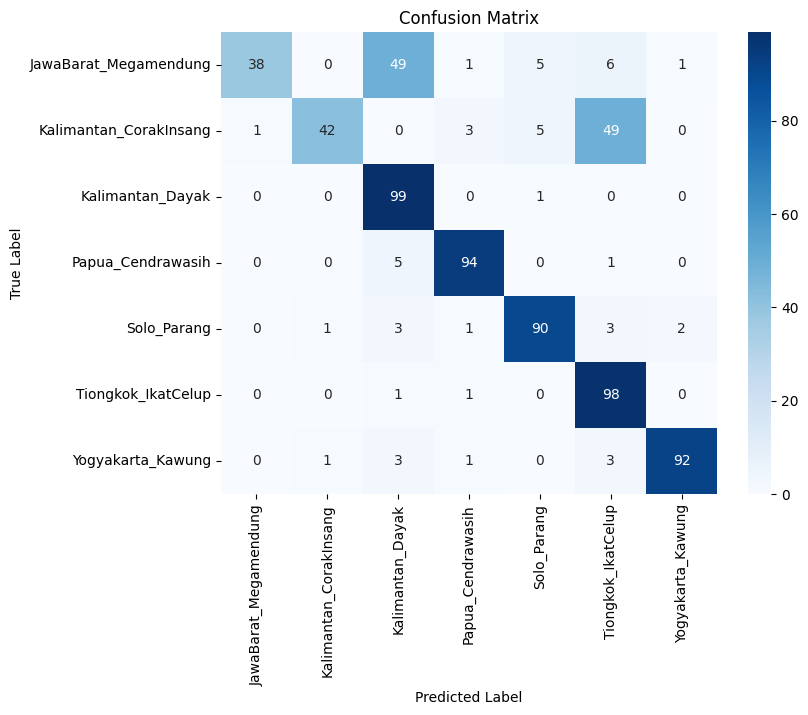

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.97      0.38      0.55       100
Kalimantan_CorakInsang       0.95      0.42      0.58       100
      Kalimantan_Dayak       0.62      0.99      0.76       100
     Papua_Cendrawasih       0.93      0.94      0.94       100
           Solo_Parang       0.89      0.90      0.90       100
    Tiongkok_IkatCelup       0.61      0.98      0.75       100
     Yogyakarta_Kawung       0.97      0.92      0.94       100

              accuracy                           0.79       700
             macro avg       0.85      0.79      0.77       700
          weighted avg       0.85      0.79      0.77       700



In [8]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold2.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_11140\2186660190.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


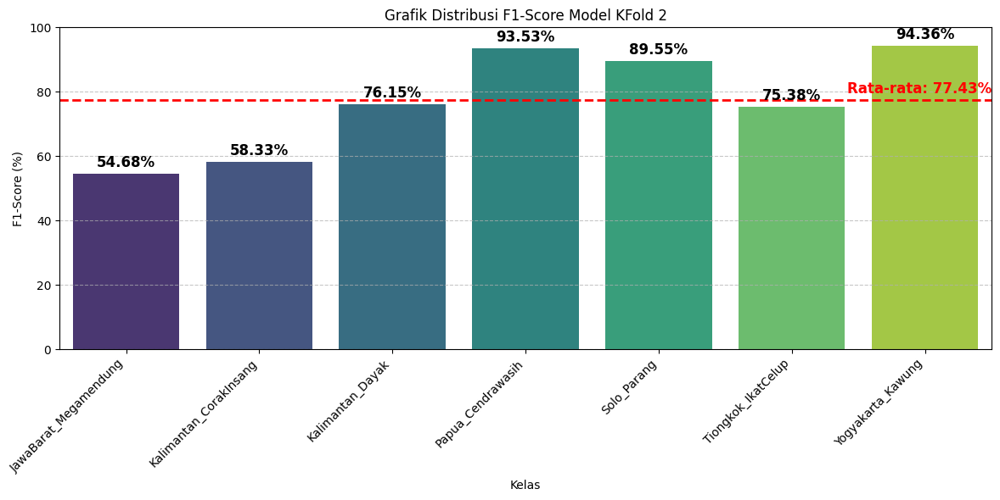

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 2")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 3

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 803ms/step


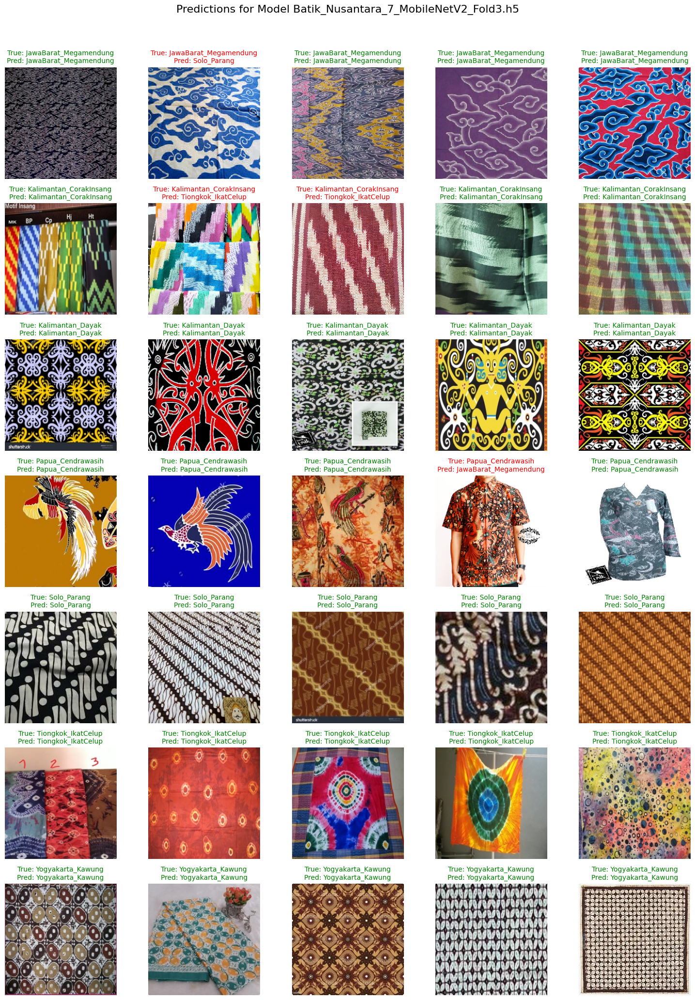

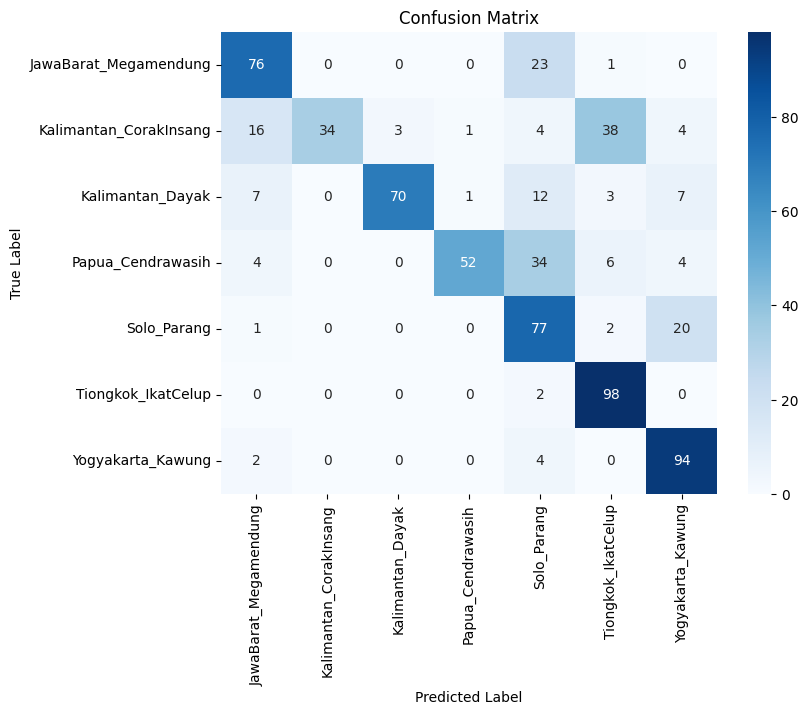

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.72      0.76      0.74       100
Kalimantan_CorakInsang       1.00      0.34      0.51       100
      Kalimantan_Dayak       0.96      0.70      0.81       100
     Papua_Cendrawasih       0.96      0.52      0.68       100
           Solo_Parang       0.49      0.77      0.60       100
    Tiongkok_IkatCelup       0.66      0.98      0.79       100
     Yogyakarta_Kawung       0.73      0.94      0.82       100

              accuracy                           0.72       700
             macro avg       0.79      0.72      0.71       700
          weighted avg       0.79      0.72      0.71       700



In [10]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold3.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_11140\358054296.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


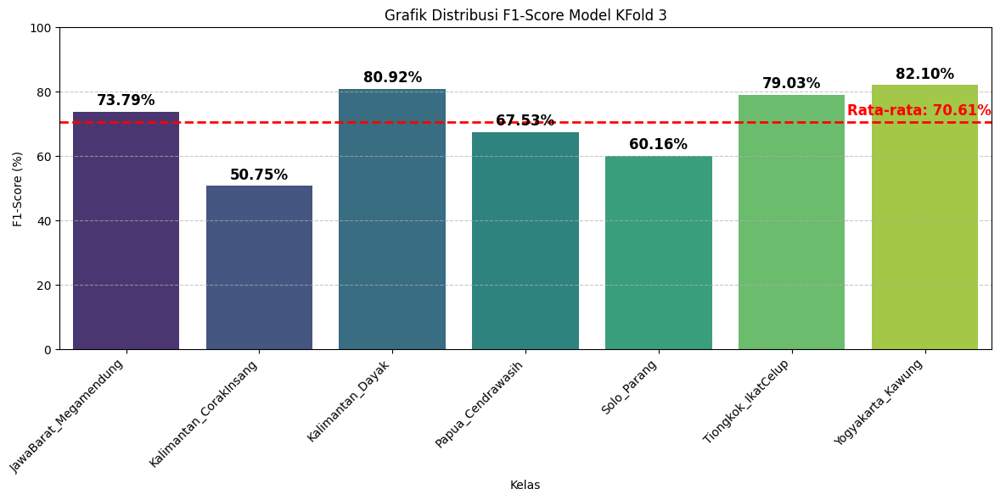

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 3")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 4

22/22 ━━━━━━━━━━━━━━━━━━━━ 18s 790ms/step


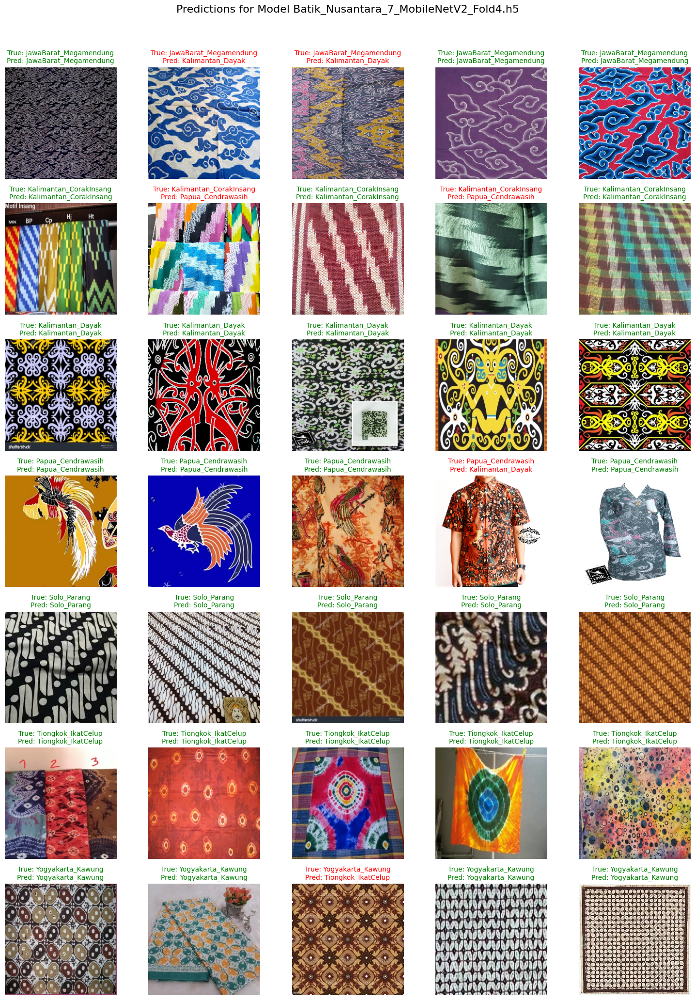

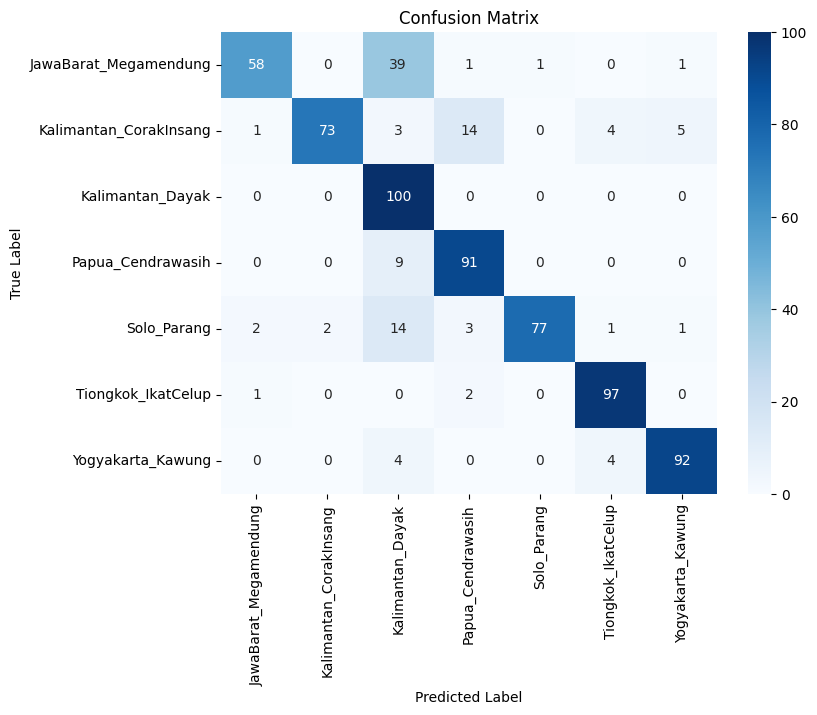

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.94      0.58      0.72       100
Kalimantan_CorakInsang       0.97      0.73      0.83       100
      Kalimantan_Dayak       0.59      1.00      0.74       100
     Papua_Cendrawasih       0.82      0.91      0.86       100
           Solo_Parang       0.99      0.77      0.87       100
    Tiongkok_IkatCelup       0.92      0.97      0.94       100
     Yogyakarta_Kawung       0.93      0.92      0.92       100

              accuracy                           0.84       700
             macro avg       0.88      0.84      0.84       700
          weighted avg       0.88      0.84      0.84       700



In [12]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold4.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_11140\276641823.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


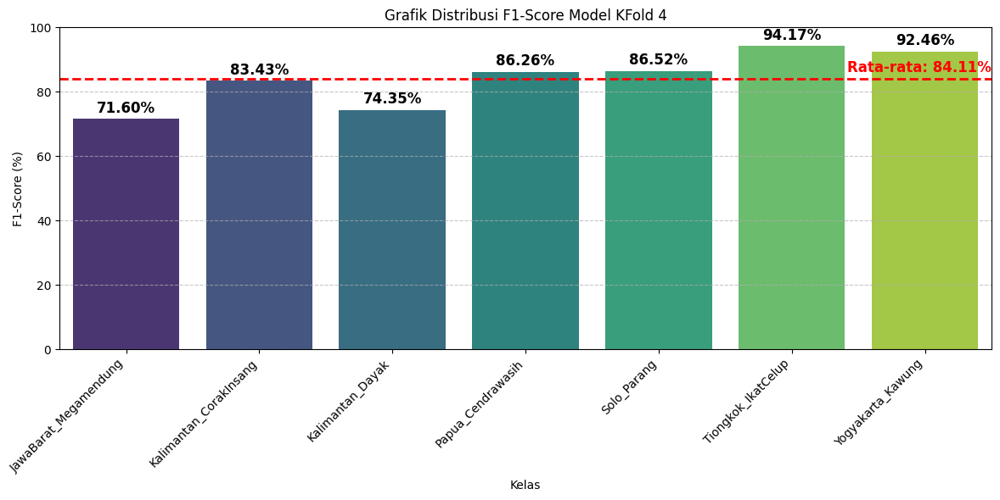

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 4")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 5

22/22 ━━━━━━━━━━━━━━━━━━━━ 19s 835ms/step


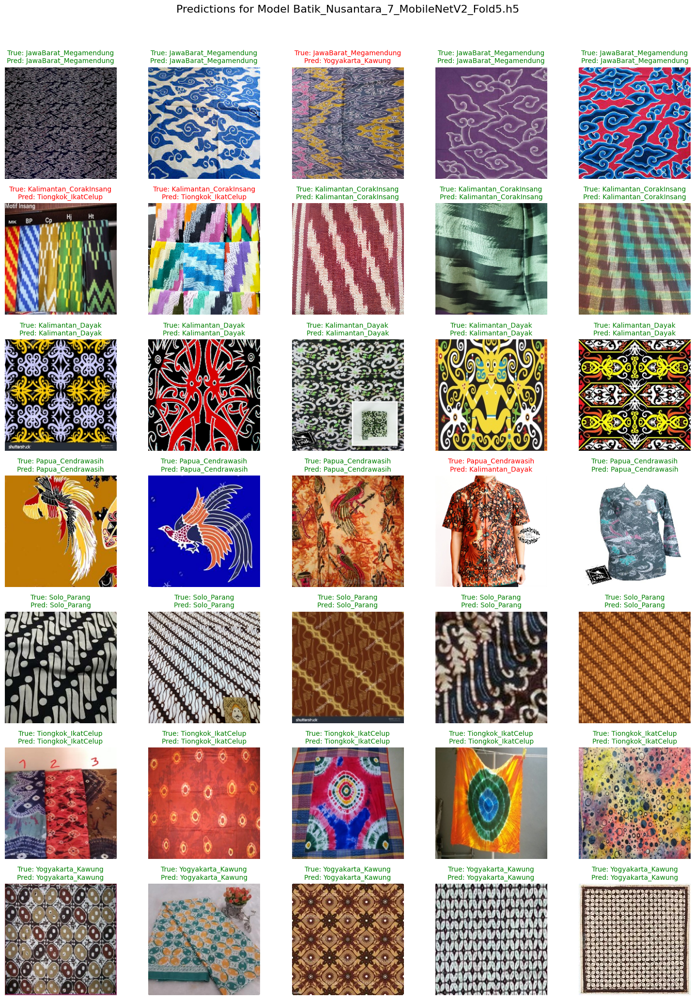

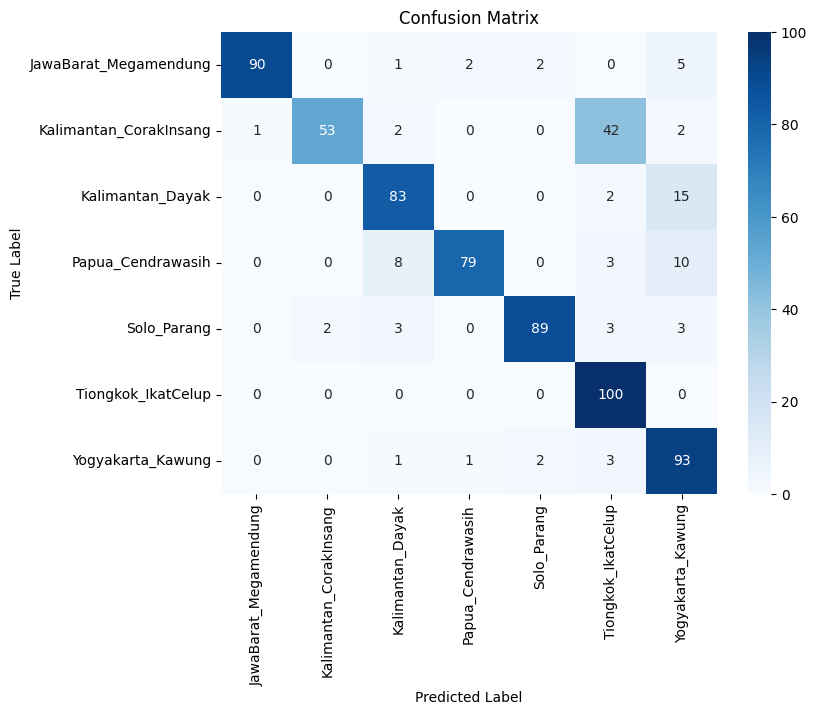

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.99      0.90      0.94       100
Kalimantan_CorakInsang       0.96      0.53      0.68       100
      Kalimantan_Dayak       0.85      0.83      0.84       100
     Papua_Cendrawasih       0.96      0.79      0.87       100
           Solo_Parang       0.96      0.89      0.92       100
    Tiongkok_IkatCelup       0.65      1.00      0.79       100
     Yogyakarta_Kawung       0.73      0.93      0.82       100

              accuracy                           0.84       700
             macro avg       0.87      0.84      0.84       700
          weighted avg       0.87      0.84      0.84       700



In [14]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold5.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_11140\4055511063.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


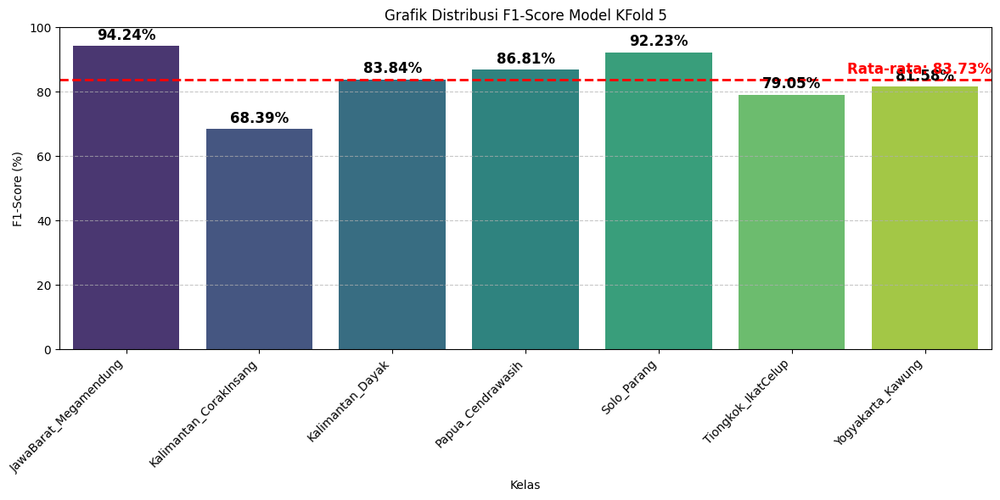

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 5")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


In [29]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

# Load model
loaded_model = tf.keras.models.load_model('Batik_Nusantara_7_MobileNetV2_Fold5.h5')
loaded_model = tf.keras.models.load_model('../Batik_Nusantara_7_MobileNetV2_augmented_Freeze/Batik_Nusantara_7_MobileNetV2_Fold5.h5')

# Path ke direktori testing dataset
dataset_test_dir = "../../Dataset_Testing"

# Ambil nama kelas dari model (bukan dari folder testing!)
class_names = sorted(os.listdir("../../Dataset/Dataset_Nusantara_7_augmented/augment"))
print("\nNama Kelas:", class_names, "\n")

# Loop setiap folder kelas dan gambar-gambarnya
for class_folder in os.listdir(dataset_test_dir):
    class_folder_path = os.path.join(dataset_test_dir, class_folder)

    # Lewati jika bukan folder
    if not os.path.isdir(class_folder_path):
        continue

    print(f"\n🔍 Kelas Asli (folder): {class_folder}")

    for img_name in os.listdir(class_folder_path):
        img_path = os.path.join(class_folder_path, img_name)

        try:
            # Load dan preprocess gambar
            img = image.load_img(img_path, target_size=(224, 224))
            img_array = image.img_to_array(img)
            img_array = np.expand_dims(img_array, axis=0)
            img_array = preprocess_input(img_array)

            # Prediksi
            predictions = loaded_model.predict(img_array)
            predicted_class_indices = np.argmax(predictions, axis=1)
            predicted_class_name = class_names[predicted_class_indices[0]]

            print(f"  📄 File: {img_name} | Actual: {class_folder:<20} | Prediksi: {predicted_class_name}")

        except Exception as e:
            print(f"  ❌ Gagal memproses gambar: {img_name}, error: {e}")



Nama Kelas: ['JawaBarat_Megamendung', 'Kalimantan_CorakInsang', 'Kalimantan_Dayak', 'Papua_Cendrawasih', 'Solo_Parang', 'Tiongkok_IkatCelup', 'Yogyakarta_Kawung'] 


🔍 Kelas Asli (folder): JawaBarat_Megamendung

🔍 Kelas Asli (folder): Kalimantan_CorakInsang
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step
  📄 File: test_corakinsang.jpg | Actual: Kalimantan_CorakInsang | Prediksi: Kalimantan_CorakInsang
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
  📄 File: test_corakinsang2.jpg | Actual: Kalimantan_CorakInsang | Prediksi: Solo_Parang
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
  📄 File: test_corakinsang3.jpg | Actual: Kalimantan_CorakInsang | Prediksi: Kalimantan_CorakInsang

🔍 Kelas Asli (folder): Kalimantan_Dayak
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
  📄 File: test_dayak.jpg | Actual: Kalimantan_Dayak     | Prediksi: Kalimantan_Dayak
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
  📄 File: test_dayak2.jpg | Actual: Kalimantan_Dayak     | Prediksi: Kalimantan_Dayak

🔍 Kelas Asli (folder): Papua_Cendrawasih
1/1 ━━━━

In [22]:
import numpy as np

# Contoh hasil akurasi dari 5 fold 
accuracies = [ 54.71, 79.00, 71.57, 84.00, 83.86 ]

# Menghitung standar deviasi
std_dev = np.std(accuracies)
mean = np.mean(accuracies)

print(f"standar Deviasi Akurasi Model: {std_dev:.4f}")
print(f"Rata-rata akurasi Model: {mean:.4f}")

standar Deviasi Akurasi Model: 10.9385
Rata-rata akurasi Model: 74.6280
